In [1]:
import torch
import sys
import types
from torchvision.transforms.functional import to_tensor, to_pil_image, rgb_to_grayscale
from PIL import Image
import torchvision.transforms as transforms
import torchvision.datasets as dset
import os
import kagglehub
import numpy as np
from tqdm import tqdm
import torch.nn as nn
import torch.optim as optim
import torch.nn.utils.spectral_norm as spectral_norm
from torchvision.models import vgg19, VGG19_Weights
import time
from torch.utils.data import DataLoader, Dataset
import glob
import torch.nn.functional as F
import torchvision
import matplotlib.pyplot as plt
import json

# Create a module for `torchvision.transforms.functional_tensor`
functional_tensor = types.ModuleType("torchvision.transforms.functional_tensor")
functional_tensor.rgb_to_grayscale = rgb_to_grayscale

# Add this module to sys.modules so other imports can access it
sys.modules["torchvision.transforms.functional_tensor"] = functional_tensor
from basicsr.archs.rrdbnet_arch import RRDBNet


In [2]:
num_epochs = 25
batch_size = 16
upscale_factor = 4  # Scale factor in generator
lr_img_size = 64
hr_img_size = lr_img_size * upscale_factor
dataset_lenght = 5000
lr = 0.0001
gen_num_block = 6

# === Step 1: Set Paths ===
base_path = os.path.expanduser("~/real-esrgan-imitation-training-data") 
lr_path = os.path.join(base_path, "lr_images")
hr_path = os.path.join(base_path, f"hr{'+' if upscale_factor==4 else ''}_images")

# Training Dataset Preperation

In [3]:
# Check if dataset has already been created
if not os.path.exists(lr_path) or not os.path.exists(hr_path) or len(os.listdir(lr_path)) == 0 or len(os.listdir(hr_path)) == 0:
    print("🚀 Creating dataset, as it's missing or incomplete...")

    # Create directories if they don't exist
    os.makedirs(lr_path, exist_ok=True)
    os.makedirs(hr_path, exist_ok=True)
    
    # === Step 2: Get Device ===
    def get_device():
        if torch.cuda.is_available():
            return torch.device("cuda")
        elif torch.backends.mps.is_available():
            return torch.device("mps")
        else:
            return torch.device("cpu")
    
    device = get_device()
    
    # === Step 3: Load Pretrained Real-ESRGAN Model ===
    model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=6, num_grow_ch=32, scale=4).to(device)
    
    checkpoint = torch.load("../Real-ESRGAN/weights/RealESRGAN_x4plus_anime_6B.pth", map_location=device)
    if 'params_ema' in checkpoint:
        model.load_state_dict(checkpoint["params_ema"], strict=True)
    else:
        model.load_state_dict(checkpoint, strict=True)
    model.eval()
    
    # === Step 4: Load Kaggle Dataset ===
    dataset_name = "soumikrakshit/anime-faces"
    path = kagglehub.dataset_download(dataset_name)
    dataset = dset.ImageFolder(root=path, 
                              transform=transforms.Compose([
                                  transforms.Resize(64),
                                  transforms.CenterCrop(64),
                              ]))
    
    # === Step 5: Select 10,000 Random Images ===
    image_indices = np.random.choice(len(dataset), size=dataset_lenght, replace=False)
    
    # === Step 6: Process and Save Images ===
    for i in tqdm(range(1, dataset_lenght+1), desc="Processing Images", unit="image"):
        idx = image_indices[i - 1]  # Ensure correct indexing
    
        # Load image
        lr_image = dataset[idx][0]  # Low-resolution (64x64)
        
        # Convert to tensor & send to device
        img_tensor = to_tensor(lr_image).unsqueeze(0).to(device)
    
        # Generate high-resolution image (256x256)
        with torch.no_grad():
            output_tensor = model(img_tensor).clamp(0,1)
    
        # Convert to PIL image
        hr_image_256 = to_pil_image(output_tensor.squeeze(0))
    
        # Save images in ~/vision-project-images/
        lr_image.save(os.path.join(lr_path, f"{i}.png"))  # Save as 64x64
        hr_image_256.save(os.path.join(hr_path, f"{i}.png"))  # Save as 128x128
    
    print(f"✅ Low-resolution images saved in: {lr_path}")
    print(f"✅ High-resolution images saved in: {hr_path}")


else:
    print("✅ Dataset already exists. Skipping dataset creation.")


✅ Dataset already exists. Skipping dataset creation.


# Dataset & Dataloader

In [4]:
# Custom Dataset for Anime Faces
class AnimeFaceDataset(Dataset):
    def __init__(self, lr_folder, hr_folder, lr_size, hr_size):
        self.lr_images = sorted(glob.glob(os.path.join(lr_folder, "*.png")))
        self.hr_images = sorted(glob.glob(os.path.join(hr_folder, "*.png")))
        
        # Basic transforms
        self.lr_transform = transforms.Compose([
            transforms.Resize(lr_size),
            transforms.ToTensor()
        ])
        self.hr_transform = transforms.Compose([
            transforms.Resize(hr_size),
            transforms.ToTensor()
        ])

    
    def __len__(self):
        return len(self.hr_images)
    
    def __getitem__(self, idx):
        lr_img = Image.open(self.lr_images[idx]).convert('RGB')
        hr_img = Image.open(self.hr_images[idx]).convert('RGB')
        
        # Create low-resolution version
        lr_img = self.lr_transform(lr_img)
        
        # Transform high-resolution image
        hr_img = self.hr_transform(hr_img)
        
        return lr_img, hr_img

In [5]:
dataset = AnimeFaceDataset(lr_path, hr_path, lr_size=(lr_img_size, lr_img_size), hr_size=(hr_img_size, hr_img_size))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Generator

In [6]:
def get_device():
    if torch.cuda.is_available():
        return torch.device("cuda")
    elif torch.backends.mps.is_available():
        return torch.device("mps")
    else:
        return torch.device("cpu")

device = get_device()

In [7]:
# Helper function to initialize weights
@torch.no_grad()
def default_init_weights(module_list, scale=1, bias_fill=0, **kwargs):
    if not isinstance(module_list, list):
        module_list = [module_list]
    for module in module_list:
        for m in module.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, **kwargs)
                m.weight.data *= scale
                if m.bias is not None:
                    m.bias.data.fill_(bias_fill)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, **kwargs)
                m.weight.data *= scale
                if m.bias is not None:
                    m.bias.data.fill_(bias_fill)
            elif isinstance(m, _BatchNorm):
                init.constant_(m.weight, 1)
                if m.bias is not None:
                    m.bias.data.fill_(bias_fill)

# Pixel Unshuffle for downsampling
def pixel_unshuffle(x, scale):
    b, c, hh, hw = x.size()
    out_channel = c * (scale**2)
    assert hh % scale == 0 and hw % scale == 0
    h = hh // scale
    w = hw // scale
    x_view = x.view(b, c, h, scale, w, scale)
    return x_view.permute(0, 1, 3, 5, 2, 4).reshape(b, out_channel, h, w)



In [8]:
# RRDBNet (Residual in Residual Dense Block Network) architecture
class ResidualDenseBlock(nn.Module):
    def __init__(self, channels=64, growth_channels=32):
        super(ResidualDenseBlock, self).__init__()
        self.conv1 = nn.Conv2d(channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(channels + growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(channels + 2 * growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv4 = nn.Conv2d(channels + 3 * growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv5 = nn.Conv2d(channels + 4 * growth_channels, channels, kernel_size=3, stride=1, padding=1)
        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)
        self.beta = 0.2  # Scaling factor
        
        # initialization
        default_init_weights([self.conv1, self.conv2, self.conv3, self.conv4, self.conv5], 0.1)
        
        
    def forward(self, x):
        x1 = self.lrelu(self.conv1(x))
        x2 = self.lrelu(self.conv2(torch.cat((x, x1), 1)))
        x3 = self.lrelu(self.conv3(torch.cat((x, x1, x2), 1)))
        x4 = self.lrelu(self.conv4(torch.cat((x, x1, x2, x3), 1)))
        x5 = self.conv5(torch.cat((x, x1, x2, x3, x4), 1))
        return x5 * self.beta + x

In [9]:
class RRDB(nn.Module):
    def __init__(self, channels=64):
        super(RRDB, self).__init__()
        self.rdb1 = ResidualDenseBlock(channels)
        self.rdb2 = ResidualDenseBlock(channels)
        self.rdb3 = ResidualDenseBlock(channels)
        self.beta = 0.2
        
    def forward(self, x):
        out = self.rdb1(x)
        out = self.rdb2(out)
        out = self.rdb3(out)
        return out * self.beta + x

In [10]:
# Generator Network
class Generator(nn.Module):
    def __init__(self, num_in_ch=3, num_out_ch=3, scale=2, num_feat=64, num_block=6, num_grow_ch=32):
        super(Generator, self).__init__()
        self.scale = scale
        if scale == 2:
            num_in_ch = num_in_ch * 4
        elif scale == 1:
            num_in_ch = num_in_ch * 16
            
        self.conv_first = nn.Conv2d(num_in_ch, num_feat, 3, 1, 1)
        self.body = nn.Sequential(*[RRDB(num_feat) for _ in range(num_block)])
        self.conv_body = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        
        # upsample
        self.conv_up1 = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_up2 = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_hr = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_last = nn.Conv2d(num_feat, num_out_ch, 3, 1, 1)

        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)

    def forward(self, x):
        if self.scale == 2:
            feat = pixel_unshuffle(x, scale=2)
        elif self.scale == 1:
            feat = pixel_unshuffle(x, scale=4)
        else:
            feat = x
            
        feat = self.conv_first(feat)
        body_feat = self.conv_body(self.body(feat))
        feat = feat + body_feat
        
        # upsample
        feat = self.lrelu(self.conv_up1(F.interpolate(feat, scale_factor=2, mode='nearest')))
        feat = self.lrelu(self.conv_up2(F.interpolate(feat, scale_factor=2, mode='nearest')))
        out = self.conv_last(self.lrelu(self.conv_hr(feat)))
        
        return out

# Discriminator

In [11]:
class Discriminator(nn.Module):
    def __init__(self, num_input=3, num_feat=64, skip_connection=True):
        super(Discriminator, self).__init__()
        self.skip_connection = skip_connection
        norm = spectral_norm
        self.conv0 = nn.Conv2d(num_input, num_feat, 3, 1, 1)  # Assume the input image has a resolution of 256x256 (can also be 128x128)
        self.conv1 = norm(nn.Conv2d(num_feat, num_feat * 2, 4, 2, 1, bias=False))  # 256x256 --> 128x128
        self.conv2 = norm(nn.Conv2d(num_feat * 2, num_feat * 4, 4, 2, 1, bias=False))  # 128x128 --> 64x64
        self.conv3 = norm(nn.Conv2d(num_feat * 4, num_feat * 8, 4, 2, 1, bias=False))  # 64x64 --> 32x32
        self.conv4 = norm(nn.Conv2d(num_feat * 8, num_feat * 4, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv5 = norm(nn.Conv2d(num_feat * 4, num_feat * 2, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv6 = norm(nn.Conv2d(num_feat * 2, num_feat, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv7 = norm(nn.Conv2d(num_feat, num_feat, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv8 = norm(nn.Conv2d(num_feat, num_feat, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv9 = norm(nn.Conv2d(num_feat, 1, 3, 1, 1, bias=False))  # 32x32 --> 32x32

    def forward(self, x):
        y1 = F.leaky_relu(self.conv0(x), 0.2, inplace=True)
        y2 = F.leaky_relu(self.conv1(y1), 0.2, inplace=True)
        y3 = F.leaky_relu(self.conv2(y2), 0.2, inplace=True)
        y4 = F.leaky_relu(self.conv3(y3), 0.2, inplace=True)
        y4 = F.interpolate(y4, scale_factor=2, mode='bilinear', align_corners=False)  # 32x32 --> 64x64
        y5 = F.leaky_relu(self.conv4(y4), 0.2, inplace=True)
        if self.skip_connection:
            y5 = y5 + y3
        y5 = F.interpolate(y5, scale_factor=2, mode='bilinear', align_corners=False)  # 64x64 --> 128x128
        y6 = F.leaky_relu(self.conv5(y5), 0.2, inplace=True)
        if self.skip_connection:
            y6 = y6 + y2
        y6 = F.interpolate(y6, scale_factor=2, mode='bilinear', align_corners=False)  # 128x128 --> 256x256
        y7 = F.leaky_relu(self.conv6(y6), 0.2, inplace=True)
        if self.skip_connection:
            y7 = y7 + y1
        y8 = F.leaky_relu(self.conv7(y7), 0.2, inplace=True)
        y9 = F.leaky_relu(self.conv8(y8), 0.2, inplace=True)
        out = self.conv9(y9)
        
        return out

# Loss Function

In [12]:
adversarial_loss = nn.BCEWithLogitsLoss().to(device)
content_loss = nn.MSELoss().to(device)

In [13]:
def relativistic_loss(real_pred, fake_pred):
    real_loss = adversarial_loss(real_pred - torch.mean(fake_pred), torch.ones_like(real_pred))
    fake_loss = adversarial_loss(fake_pred - torch.mean(real_pred), torch.zeros_like(fake_pred))
    out = (real_loss + fake_loss) / 2
    return out

In [14]:
class perceptual_loss(nn.Module):
    def __init__(self):
        super(perceptual_loss, self).__init__()
        # vgg = vgg19(pretrained=True)
        vgg = vgg19(weights=VGG19_Weights.IMAGENET1K_V1)
        self.feature_extractor = nn.Sequential(*list(vgg.features[:36])).eval()
        for param in self.feature_extractor.parameters():
            param.requires_grad = False

    def forward(self, x, target):
        x_features = self.feature_extractor(x)
        target_features = self.feature_extractor(target)
        loss = nn.functional.l1_loss(x_features, target_features)
        return loss

In [15]:
generator = Generator(num_in_ch=3, num_out_ch=3, scale=upscale_factor, num_feat=64, num_block=gen_num_block, num_grow_ch=32).to(device)
generator

Generator(
  (conv_first): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (body): Sequential(
    (0): RRDB(
      (rdb1): ResidualDenseBlock(
        (conv1): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv2): Conv2d(96, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv3): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv4): Conv2d(160, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv5): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (lrelu): LeakyReLU(negative_slope=0.2, inplace=True)
      )
      (rdb2): ResidualDenseBlock(
        (conv1): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv2): Conv2d(96, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv3): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv4): Conv2d(160, 32, kernel_size=(3, 3), stride=(1, 1)

In [16]:
discriminator = Discriminator().to(device)
discriminator

Discriminator(
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv3): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv4): Conv2d(512, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv5): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv6): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv7): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv8): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv9): Conv2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
)

In [17]:
feature_extractor = perceptual_loss().to(device)
feature_extractor

perceptual_loss(
  (feature_extractor): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3)

In [18]:
optimizer_g = optim.Adam(generator.parameters(), lr=lr)
optimizer_d = optim.Adam(discriminator.parameters(),lr=lr)

In [19]:
scheduler_g = optim.lr_scheduler.StepLR(optimizer_g, step_size=10, gamma=0.5)
scheduler_d = optim.lr_scheduler.StepLR(optimizer_d, step_size = 10, gamma=0.5)

In [20]:
os.makedirs("upscaled_images", exist_ok=True)

def plot_and_save_images(lr_images, sr_images, epoch, save_path='upscaled_images'):
    original_grid = torchvision.utils.make_grid(lr_images[:6].cpu(), nrow=6)
    enhanced_grid = torchvision.utils.make_grid(sr_images[:6].cpu(), nrow=6)

    original_np = original_grid.numpy().transpose((1, 2, 0))
    enhanced_np = enhanced_grid.numpy().transpose((1, 2, 0))

    plt.figure(figsize=(12, 5))
    # plt.suptitle(f'Comparison of Original and Enhanced Images (Epoch {epoch}, {upscale_factor}x Upscale)', fontsize=16)

    plt.subplot(2, 1, 1)
    plt.imshow(original_np)
    plt.title('Original Low-Resolution Images')
    plt.axis('off')

    plt.subplot(2, 1, 2)
    plt.imshow(enhanced_np)
    plt.title(f'Enhanced Super-Resolution Images(Epoch {epoch}, {upscale_factor}x Upscale)')
    plt.axis('off')

    plt.savefig(os.path.join(save_path, f'upscaled-images-{upscale_factor}x-epoch-{epoch}.png'))

    plt.tight_layout()
    plt.show()
    plt.close()

# Train

In [21]:
# Initialize lists to store losses
generator_losses = []
discriminator_losses = []

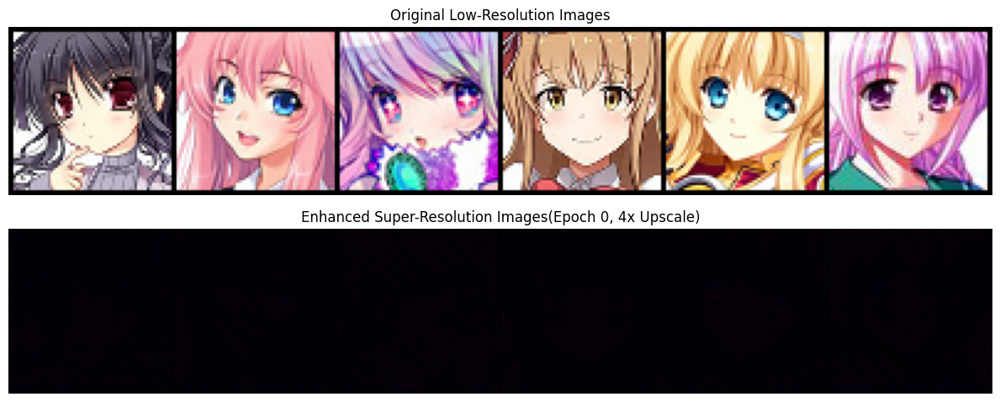

Epoch [1/25], Batch [0/313] => Discriminator Loss: 0.7061, Generator Loss: 0.4843, Batch Time: 9.4032
Epoch [1/25], Batch [10/313] => Discriminator Loss: 0.1300, Generator Loss: 0.2173, Batch Time: 5.9629
Epoch [1/25], Batch [20/313] => Discriminator Loss: 0.0498, Generator Loss: 0.1720, Batch Time: 5.6346
Epoch [1/25], Batch [30/313] => Discriminator Loss: 0.0005, Generator Loss: 0.1803, Batch Time: 5.0278
Epoch [1/25], Batch [40/313] => Discriminator Loss: 1.4246, Generator Loss: 0.0662, Batch Time: 5.3705
Epoch [1/25], Batch [50/313] => Discriminator Loss: 0.6938, Generator Loss: 0.0468, Batch Time: 5.1539
Epoch [1/25], Batch [60/313] => Discriminator Loss: 0.6927, Generator Loss: 0.0334, Batch Time: 4.5692
Epoch [1/25], Batch [70/313] => Discriminator Loss: 0.6960, Generator Loss: 0.0346, Batch Time: 6.0933
Epoch [1/25], Batch [80/313] => Discriminator Loss: 0.6930, Generator Loss: 0.0292, Batch Time: 6.6320
Epoch [1/25], Batch [90/313] => Discriminator Loss: 0.6907, Generator Loss

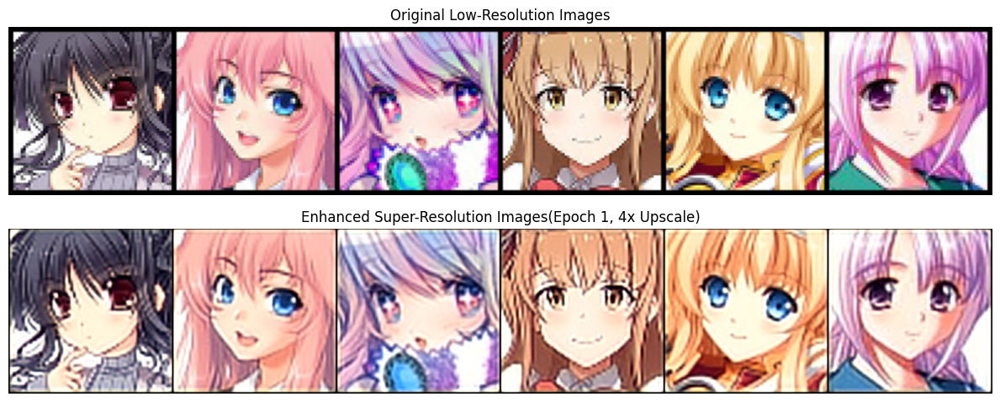

Epoch [2/25], Batch [0/313] => Discriminator Loss: 0.6903, Generator Loss: 0.0141, Batch Time: 4.9191
Epoch [2/25], Batch [10/313] => Discriminator Loss: 0.6868, Generator Loss: 0.0140, Batch Time: 4.3237
Epoch [2/25], Batch [20/313] => Discriminator Loss: 0.6829, Generator Loss: 0.0151, Batch Time: 4.9506
Epoch [2/25], Batch [30/313] => Discriminator Loss: 0.6858, Generator Loss: 0.0159, Batch Time: 4.5425
Epoch [2/25], Batch [40/313] => Discriminator Loss: 0.6892, Generator Loss: 0.0154, Batch Time: 4.4255
Epoch [2/25], Batch [50/313] => Discriminator Loss: 0.6870, Generator Loss: 0.0140, Batch Time: 4.4915
Epoch [2/25], Batch [60/313] => Discriminator Loss: 0.6829, Generator Loss: 0.0137, Batch Time: 4.3556
Epoch [2/25], Batch [70/313] => Discriminator Loss: 0.6828, Generator Loss: 0.0124, Batch Time: 4.8515
Epoch [2/25], Batch [80/313] => Discriminator Loss: 0.6843, Generator Loss: 0.0126, Batch Time: 5.2269
Epoch [2/25], Batch [90/313] => Discriminator Loss: 0.6806, Generator Loss

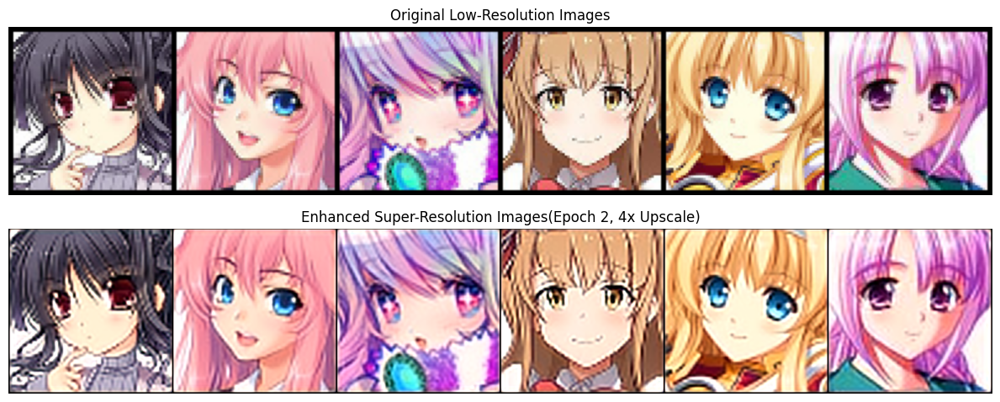

Epoch [3/25], Batch [0/313] => Discriminator Loss: 0.7046, Generator Loss: 0.0132, Batch Time: 12.2142
Epoch [3/25], Batch [10/313] => Discriminator Loss: 0.6787, Generator Loss: 0.0127, Batch Time: 4.0189
Epoch [3/25], Batch [20/313] => Discriminator Loss: 0.6594, Generator Loss: 0.0120, Batch Time: 4.0282
Epoch [3/25], Batch [30/313] => Discriminator Loss: 0.6534, Generator Loss: 0.0127, Batch Time: 4.4746
Epoch [3/25], Batch [40/313] => Discriminator Loss: 0.6115, Generator Loss: 0.0133, Batch Time: 4.0478
Epoch [3/25], Batch [50/313] => Discriminator Loss: 0.4471, Generator Loss: 0.0114, Batch Time: 3.9908
Epoch [3/25], Batch [60/313] => Discriminator Loss: 0.2064, Generator Loss: 0.0110, Batch Time: 4.9184
Epoch [3/25], Batch [70/313] => Discriminator Loss: 0.0939, Generator Loss: 0.0112, Batch Time: 5.0735
Epoch [3/25], Batch [80/313] => Discriminator Loss: 0.0583, Generator Loss: 0.0107, Batch Time: 4.0429
Epoch [3/25], Batch [90/313] => Discriminator Loss: 0.0647, Generator Los

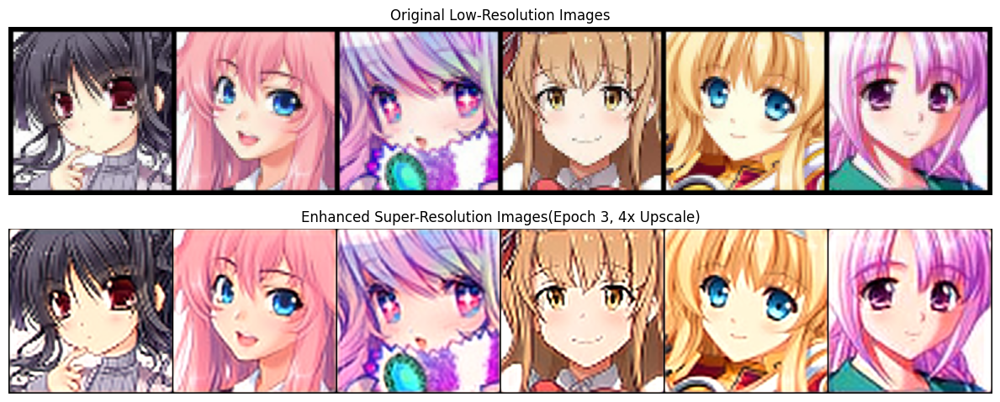

Epoch [4/25], Batch [0/313] => Discriminator Loss: 0.0019, Generator Loss: 0.0129, Batch Time: 4.9769
Epoch [4/25], Batch [10/313] => Discriminator Loss: 0.0064, Generator Loss: 0.0120, Batch Time: 5.2739
Epoch [4/25], Batch [20/313] => Discriminator Loss: 0.0038, Generator Loss: 0.0128, Batch Time: 5.0974
Epoch [4/25], Batch [30/313] => Discriminator Loss: 0.0078, Generator Loss: 0.0122, Batch Time: 4.4410
Epoch [4/25], Batch [40/313] => Discriminator Loss: 0.0072, Generator Loss: 0.0127, Batch Time: 5.0997
Epoch [4/25], Batch [50/313] => Discriminator Loss: 1.4529, Generator Loss: 0.0275, Batch Time: 4.0685
Epoch [4/25], Batch [60/313] => Discriminator Loss: 0.6564, Generator Loss: 0.0116, Batch Time: 4.3760
Epoch [4/25], Batch [70/313] => Discriminator Loss: 0.5812, Generator Loss: 0.0109, Batch Time: 4.2571
Epoch [4/25], Batch [80/313] => Discriminator Loss: 0.3126, Generator Loss: 0.0105, Batch Time: 7.0853
Epoch [4/25], Batch [90/313] => Discriminator Loss: 0.1185, Generator Loss

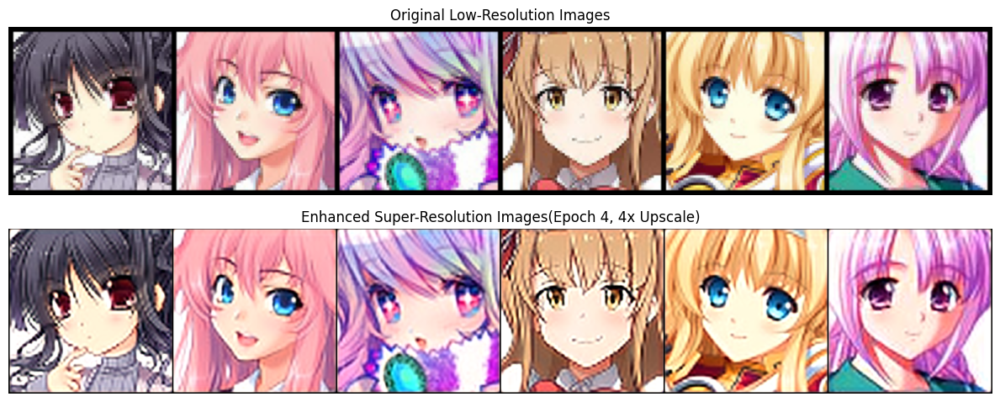

Epoch [5/25], Batch [0/313] => Discriminator Loss: 0.0164, Generator Loss: 0.0099, Batch Time: 6.0378
Epoch [5/25], Batch [10/313] => Discriminator Loss: 0.0515, Generator Loss: 0.0111, Batch Time: 4.4759
Epoch [5/25], Batch [20/313] => Discriminator Loss: 0.0186, Generator Loss: 0.0113, Batch Time: 4.0591
Epoch [5/25], Batch [30/313] => Discriminator Loss: 0.0601, Generator Loss: 0.0108, Batch Time: 4.0366
Epoch [5/25], Batch [40/313] => Discriminator Loss: 0.0145, Generator Loss: 0.0110, Batch Time: 4.2953
Epoch [5/25], Batch [50/313] => Discriminator Loss: 0.0101, Generator Loss: 0.0099, Batch Time: 4.1336
Epoch [5/25], Batch [60/313] => Discriminator Loss: 0.0054, Generator Loss: 0.0107, Batch Time: 4.6553
Epoch [5/25], Batch [70/313] => Discriminator Loss: 0.0044, Generator Loss: 0.0114, Batch Time: 4.6629
Epoch [5/25], Batch [80/313] => Discriminator Loss: 0.0024, Generator Loss: 0.0106, Batch Time: 4.0007
Epoch [5/25], Batch [90/313] => Discriminator Loss: 0.0030, Generator Loss

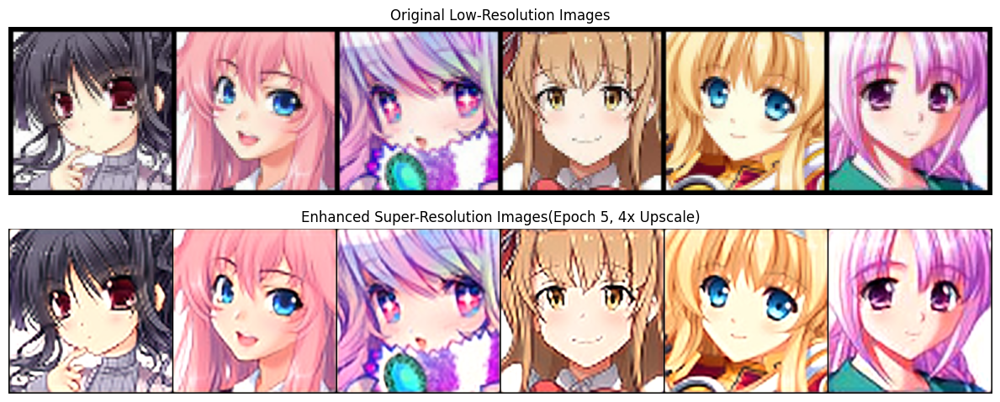

Epoch [6/25], Batch [0/313] => Discriminator Loss: 0.0008, Generator Loss: 0.0118, Batch Time: 4.3082
Epoch [6/25], Batch [10/313] => Discriminator Loss: 0.0009, Generator Loss: 0.0102, Batch Time: 6.8070
Epoch [6/25], Batch [20/313] => Discriminator Loss: 0.0012, Generator Loss: 0.0106, Batch Time: 4.5998
Epoch [6/25], Batch [30/313] => Discriminator Loss: 0.0098, Generator Loss: 0.0097, Batch Time: 5.6006
Epoch [6/25], Batch [40/313] => Discriminator Loss: 0.0024, Generator Loss: 0.0099, Batch Time: 4.3067
Epoch [6/25], Batch [50/313] => Discriminator Loss: 0.0016, Generator Loss: 0.0112, Batch Time: 4.5379
Epoch [6/25], Batch [60/313] => Discriminator Loss: 0.0012, Generator Loss: 0.0110, Batch Time: 4.7713
Epoch [6/25], Batch [70/313] => Discriminator Loss: 0.0021, Generator Loss: 0.0098, Batch Time: 4.0036
Epoch [6/25], Batch [80/313] => Discriminator Loss: 0.0012, Generator Loss: 0.0098, Batch Time: 5.1372
Epoch [6/25], Batch [90/313] => Discriminator Loss: 0.0057, Generator Loss

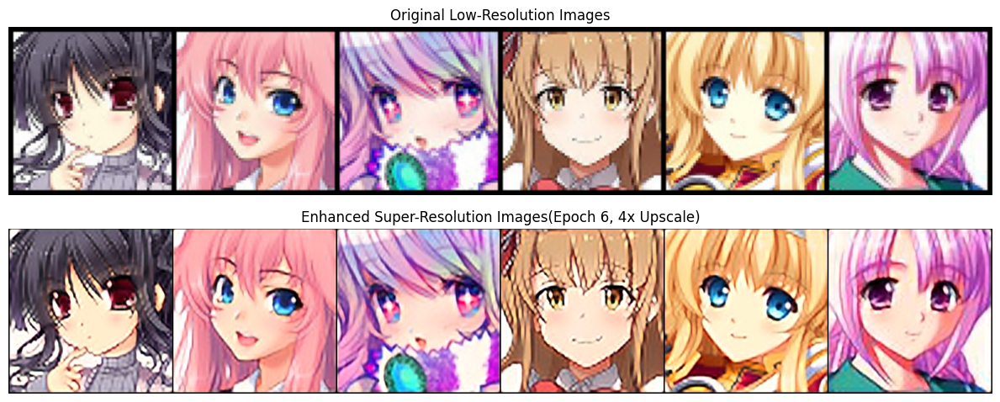

Epoch [7/25], Batch [0/313] => Discriminator Loss: 0.0037, Generator Loss: 0.0101, Batch Time: 4.5354
Epoch [7/25], Batch [10/313] => Discriminator Loss: 0.0055, Generator Loss: 0.0105, Batch Time: 4.4749
Epoch [7/25], Batch [20/313] => Discriminator Loss: 0.0129, Generator Loss: 0.0100, Batch Time: 5.0650
Epoch [7/25], Batch [30/313] => Discriminator Loss: 0.0071, Generator Loss: 0.0093, Batch Time: 4.0574
Epoch [7/25], Batch [40/313] => Discriminator Loss: 0.0106, Generator Loss: 0.0093, Batch Time: 4.0358
Epoch [7/25], Batch [50/313] => Discriminator Loss: 0.0048, Generator Loss: 0.0098, Batch Time: 5.0418
Epoch [7/25], Batch [60/313] => Discriminator Loss: 0.0053, Generator Loss: 0.0087, Batch Time: 4.0574
Epoch [7/25], Batch [70/313] => Discriminator Loss: 0.0134, Generator Loss: 0.0103, Batch Time: 4.1758
Epoch [7/25], Batch [80/313] => Discriminator Loss: 0.0027, Generator Loss: 0.0101, Batch Time: 4.2971
Epoch [7/25], Batch [90/313] => Discriminator Loss: 0.0060, Generator Loss

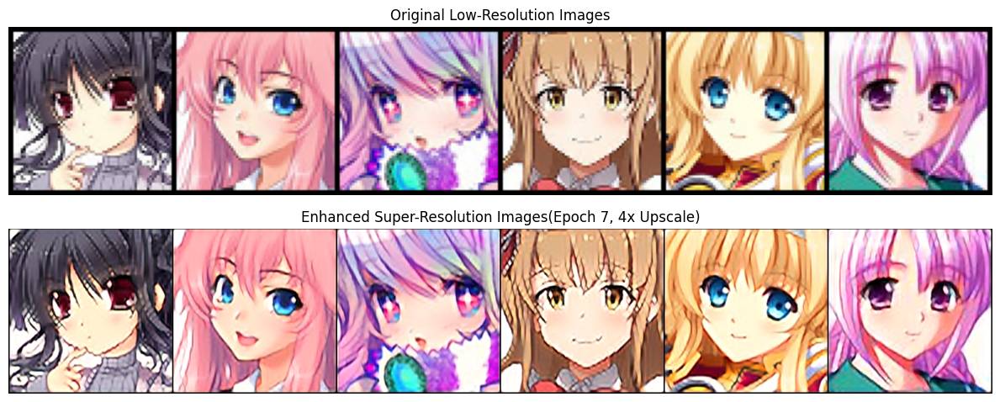

Epoch [8/25], Batch [0/313] => Discriminator Loss: 0.0112, Generator Loss: 0.0095, Batch Time: 5.7890
Epoch [8/25], Batch [10/313] => Discriminator Loss: 0.0095, Generator Loss: 0.0090, Batch Time: 4.5218
Epoch [8/25], Batch [20/313] => Discriminator Loss: 0.0115, Generator Loss: 0.0092, Batch Time: 4.0729
Epoch [8/25], Batch [30/313] => Discriminator Loss: 0.0042, Generator Loss: 0.0099, Batch Time: 4.0455
Epoch [8/25], Batch [40/313] => Discriminator Loss: 0.0282, Generator Loss: 0.0080, Batch Time: 4.4920
Epoch [8/25], Batch [50/313] => Discriminator Loss: 0.0066, Generator Loss: 0.0093, Batch Time: 4.4320
Epoch [8/25], Batch [60/313] => Discriminator Loss: 0.0142, Generator Loss: 0.0090, Batch Time: 4.0179
Epoch [8/25], Batch [70/313] => Discriminator Loss: 0.0053, Generator Loss: 0.0089, Batch Time: 4.3177
Epoch [8/25], Batch [80/313] => Discriminator Loss: 0.0105, Generator Loss: 0.0085, Batch Time: 4.8217
Epoch [8/25], Batch [90/313] => Discriminator Loss: 0.0089, Generator Loss

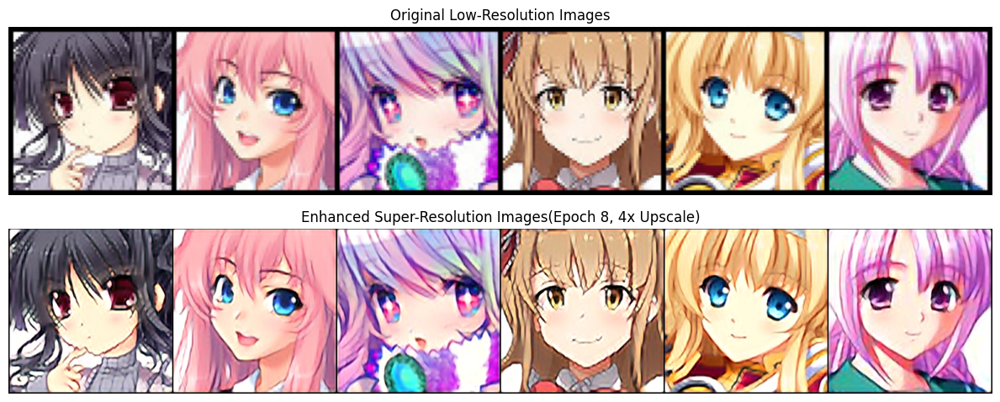

Epoch [9/25], Batch [0/313] => Discriminator Loss: 0.0363, Generator Loss: 0.0087, Batch Time: 7.7012
Epoch [9/25], Batch [10/313] => Discriminator Loss: 0.0067, Generator Loss: 0.0084, Batch Time: 4.3462
Epoch [9/25], Batch [20/313] => Discriminator Loss: 0.0480, Generator Loss: 0.0088, Batch Time: 4.8045
Epoch [9/25], Batch [30/313] => Discriminator Loss: 0.0557, Generator Loss: 0.0083, Batch Time: 4.0319
Epoch [9/25], Batch [40/313] => Discriminator Loss: 0.0079, Generator Loss: 0.0090, Batch Time: 4.6347
Epoch [9/25], Batch [50/313] => Discriminator Loss: 0.0101, Generator Loss: 0.0093, Batch Time: 5.2959
Epoch [9/25], Batch [60/313] => Discriminator Loss: 0.0072, Generator Loss: 0.0082, Batch Time: 4.0814
Epoch [9/25], Batch [70/313] => Discriminator Loss: 0.0134, Generator Loss: 0.0082, Batch Time: 3.9897
Epoch [9/25], Batch [80/313] => Discriminator Loss: 0.0101, Generator Loss: 0.0085, Batch Time: 4.1891
Epoch [9/25], Batch [90/313] => Discriminator Loss: 0.0066, Generator Loss

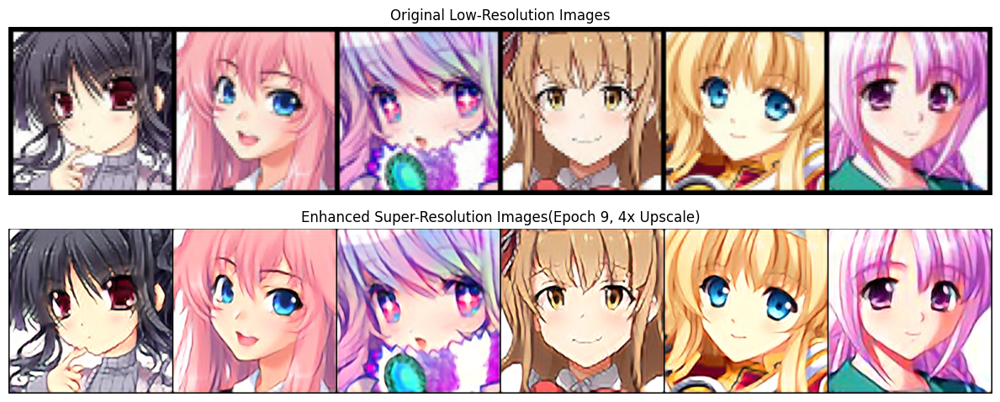

Epoch [10/25], Batch [0/313] => Discriminator Loss: 0.0078, Generator Loss: 0.0085, Batch Time: 4.3355
Epoch [10/25], Batch [10/313] => Discriminator Loss: 0.0261, Generator Loss: 0.0082, Batch Time: 4.3801
Epoch [10/25], Batch [20/313] => Discriminator Loss: 0.0289, Generator Loss: 0.0091, Batch Time: 4.5852
Epoch [10/25], Batch [30/313] => Discriminator Loss: 0.0080, Generator Loss: 0.0084, Batch Time: 4.0242
Epoch [10/25], Batch [40/313] => Discriminator Loss: 0.0091, Generator Loss: 0.0088, Batch Time: 4.4611
Epoch [10/25], Batch [50/313] => Discriminator Loss: 0.0086, Generator Loss: 0.0086, Batch Time: 4.3373
Epoch [10/25], Batch [60/313] => Discriminator Loss: 0.0145, Generator Loss: 0.0079, Batch Time: 4.6073
Epoch [10/25], Batch [70/313] => Discriminator Loss: 0.0055, Generator Loss: 0.0085, Batch Time: 5.2973
Epoch [10/25], Batch [80/313] => Discriminator Loss: 0.0071, Generator Loss: 0.0075, Batch Time: 4.0087
Epoch [10/25], Batch [90/313] => Discriminator Loss: 0.0052, Gene

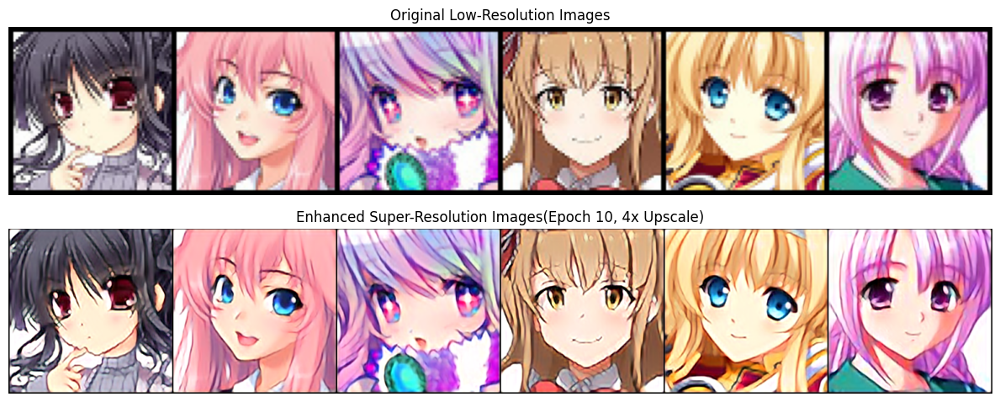

Epoch [11/25], Batch [0/313] => Discriminator Loss: 0.6501, Generator Loss: 0.0088, Batch Time: 5.2654
Epoch [11/25], Batch [10/313] => Discriminator Loss: 0.6368, Generator Loss: 0.0088, Batch Time: 5.0193
Epoch [11/25], Batch [20/313] => Discriminator Loss: 0.7296, Generator Loss: 0.0088, Batch Time: 5.1134
Epoch [11/25], Batch [30/313] => Discriminator Loss: 0.2926, Generator Loss: 0.0083, Batch Time: 5.8225
Epoch [11/25], Batch [40/313] => Discriminator Loss: 0.2146, Generator Loss: 0.0075, Batch Time: 5.2045
Epoch [11/25], Batch [50/313] => Discriminator Loss: 0.0461, Generator Loss: 0.0085, Batch Time: 4.6565
Epoch [11/25], Batch [60/313] => Discriminator Loss: 0.0323, Generator Loss: 0.0077, Batch Time: 4.4658
Epoch [11/25], Batch [70/313] => Discriminator Loss: 0.0448, Generator Loss: 0.0076, Batch Time: 5.1637
Epoch [11/25], Batch [80/313] => Discriminator Loss: 0.0202, Generator Loss: 0.0079, Batch Time: 5.7221
Epoch [11/25], Batch [90/313] => Discriminator Loss: 0.0172, Gene

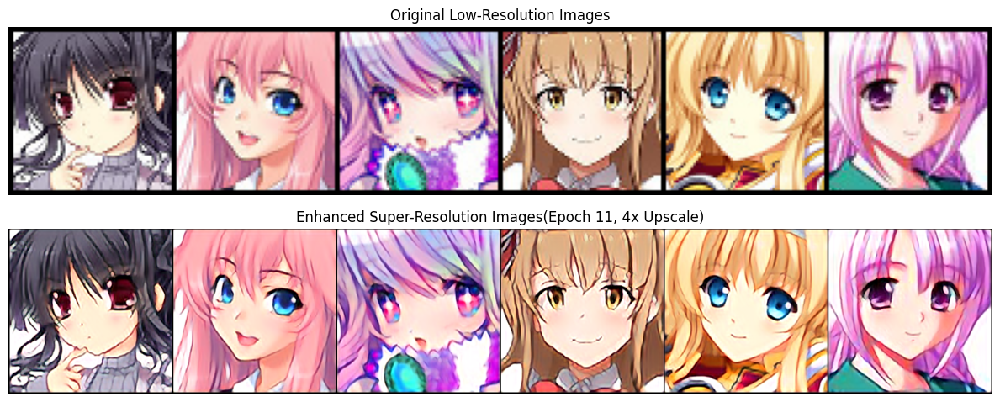

Epoch [12/25], Batch [0/313] => Discriminator Loss: 0.0512, Generator Loss: 0.0074, Batch Time: 5.5048
Epoch [12/25], Batch [10/313] => Discriminator Loss: 0.0425, Generator Loss: 0.0078, Batch Time: 4.0914
Epoch [12/25], Batch [20/313] => Discriminator Loss: 0.0142, Generator Loss: 0.0079, Batch Time: 4.5362
Epoch [12/25], Batch [30/313] => Discriminator Loss: 0.0198, Generator Loss: 0.0069, Batch Time: 4.4488
Epoch [12/25], Batch [40/313] => Discriminator Loss: 0.0167, Generator Loss: 0.0080, Batch Time: 4.8874
Epoch [12/25], Batch [50/313] => Discriminator Loss: 0.0097, Generator Loss: 0.0076, Batch Time: 4.4651
Epoch [12/25], Batch [60/313] => Discriminator Loss: 0.0115, Generator Loss: 0.0075, Batch Time: 4.5796
Epoch [12/25], Batch [70/313] => Discriminator Loss: 0.0123, Generator Loss: 0.0074, Batch Time: 4.1718
Epoch [12/25], Batch [80/313] => Discriminator Loss: 0.0143, Generator Loss: 0.0069, Batch Time: 4.3506
Epoch [12/25], Batch [90/313] => Discriminator Loss: 0.0090, Gene

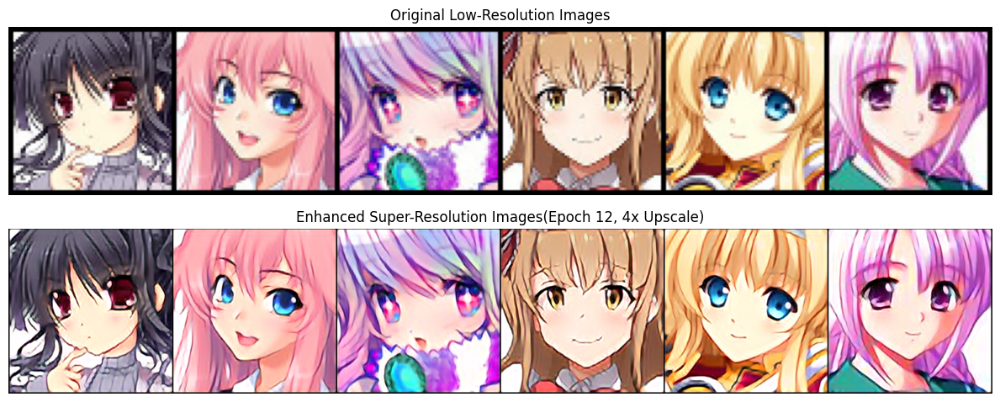

Epoch [13/25], Batch [0/313] => Discriminator Loss: 0.0092, Generator Loss: 0.0077, Batch Time: 5.2102
Epoch [13/25], Batch [10/313] => Discriminator Loss: 0.0149, Generator Loss: 0.0073, Batch Time: 4.4803
Epoch [13/25], Batch [20/313] => Discriminator Loss: 0.0127, Generator Loss: 0.0080, Batch Time: 4.3831
Epoch [13/25], Batch [30/313] => Discriminator Loss: 0.0112, Generator Loss: 0.0072, Batch Time: 5.1351
Epoch [13/25], Batch [40/313] => Discriminator Loss: 0.0100, Generator Loss: 0.0082, Batch Time: 3.9980
Epoch [13/25], Batch [50/313] => Discriminator Loss: 0.0066, Generator Loss: 0.0085, Batch Time: 4.3497
Epoch [13/25], Batch [60/313] => Discriminator Loss: 0.0084, Generator Loss: 0.0075, Batch Time: 4.1037
Epoch [13/25], Batch [70/313] => Discriminator Loss: 0.0133, Generator Loss: 0.0074, Batch Time: 4.4502
Epoch [13/25], Batch [80/313] => Discriminator Loss: 0.0072, Generator Loss: 0.0076, Batch Time: 4.0024
Epoch [13/25], Batch [90/313] => Discriminator Loss: 0.0096, Gene

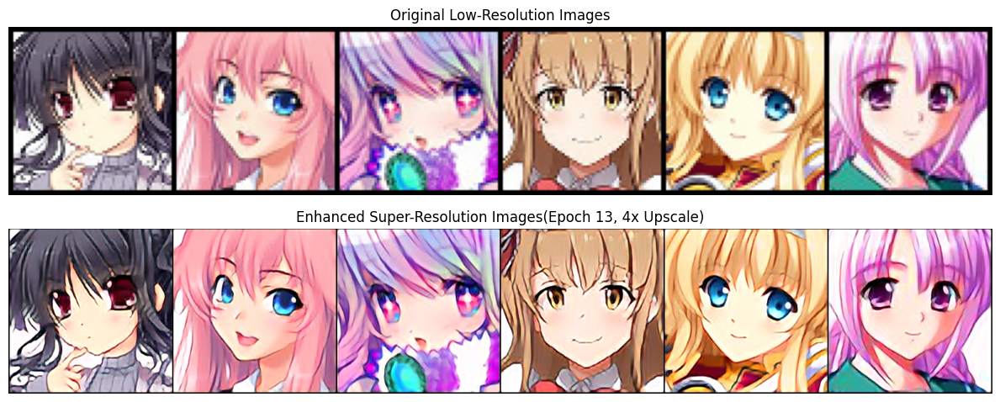

Epoch [14/25], Batch [0/313] => Discriminator Loss: 0.0134, Generator Loss: 0.0076, Batch Time: 6.4814
Epoch [14/25], Batch [10/313] => Discriminator Loss: 0.0154, Generator Loss: 0.0073, Batch Time: 4.5114
Epoch [14/25], Batch [20/313] => Discriminator Loss: 0.0159, Generator Loss: 0.0078, Batch Time: 4.9614
Epoch [14/25], Batch [30/313] => Discriminator Loss: 0.0114, Generator Loss: 0.0072, Batch Time: 4.2779
Epoch [14/25], Batch [40/313] => Discriminator Loss: 0.0072, Generator Loss: 0.0074, Batch Time: 4.3323
Epoch [14/25], Batch [50/313] => Discriminator Loss: 0.0072, Generator Loss: 0.0080, Batch Time: 4.4806
Epoch [14/25], Batch [60/313] => Discriminator Loss: 0.0089, Generator Loss: 0.0075, Batch Time: 4.1733
Epoch [14/25], Batch [70/313] => Discriminator Loss: 0.0146, Generator Loss: 0.0076, Batch Time: 4.4788
Epoch [14/25], Batch [80/313] => Discriminator Loss: 0.0275, Generator Loss: 0.0074, Batch Time: 4.0626
Epoch [14/25], Batch [90/313] => Discriminator Loss: 0.0086, Gene

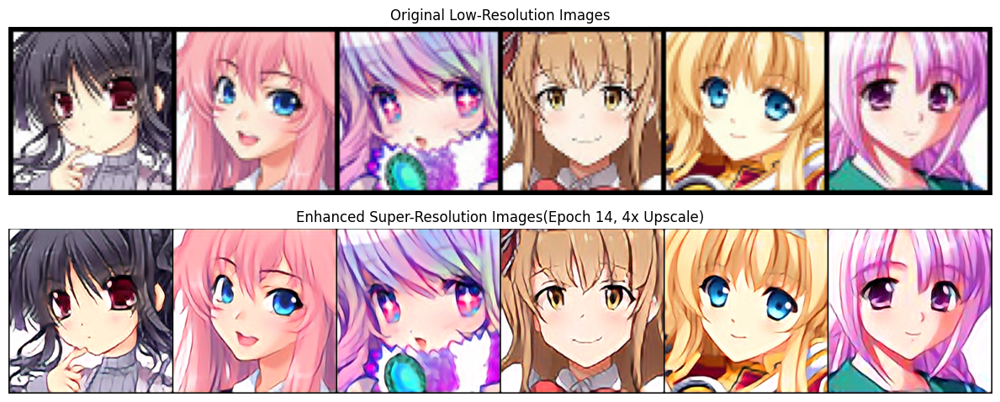

Epoch [15/25], Batch [0/313] => Discriminator Loss: 0.0295, Generator Loss: 0.0068, Batch Time: 7.4323
Epoch [15/25], Batch [10/313] => Discriminator Loss: 0.0291, Generator Loss: 0.0075, Batch Time: 4.2355
Epoch [15/25], Batch [20/313] => Discriminator Loss: 0.0490, Generator Loss: 0.0071, Batch Time: 4.0411
Epoch [15/25], Batch [30/313] => Discriminator Loss: 0.0178, Generator Loss: 0.0075, Batch Time: 4.4271
Epoch [15/25], Batch [40/313] => Discriminator Loss: 0.0311, Generator Loss: 0.0067, Batch Time: 4.1020
Epoch [15/25], Batch [50/313] => Discriminator Loss: 0.0095, Generator Loss: 0.0076, Batch Time: 4.4641
Epoch [15/25], Batch [60/313] => Discriminator Loss: 0.0151, Generator Loss: 0.0072, Batch Time: 4.3600
Epoch [15/25], Batch [70/313] => Discriminator Loss: 0.0139, Generator Loss: 0.0071, Batch Time: 4.5507
Epoch [15/25], Batch [80/313] => Discriminator Loss: 0.0211, Generator Loss: 0.0071, Batch Time: 4.5288
Epoch [15/25], Batch [90/313] => Discriminator Loss: 0.0121, Gene

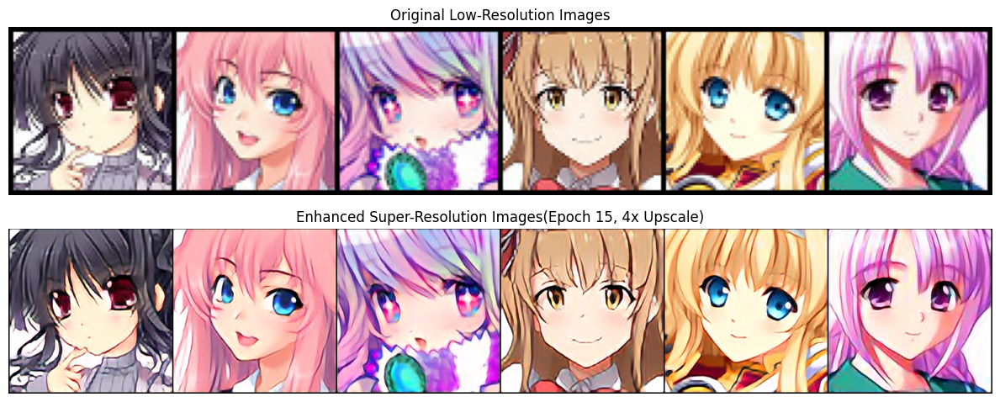

Epoch [16/25], Batch [0/313] => Discriminator Loss: 0.0224, Generator Loss: 0.0072, Batch Time: 4.8161
Epoch [16/25], Batch [10/313] => Discriminator Loss: 0.0315, Generator Loss: 0.0065, Batch Time: 4.8827
Epoch [16/25], Batch [20/313] => Discriminator Loss: 0.0418, Generator Loss: 0.0069, Batch Time: 4.0421
Epoch [16/25], Batch [30/313] => Discriminator Loss: 0.0667, Generator Loss: 0.0067, Batch Time: 5.4597
Epoch [16/25], Batch [40/313] => Discriminator Loss: 0.0483, Generator Loss: 0.0073, Batch Time: 5.0383
Epoch [16/25], Batch [50/313] => Discriminator Loss: 0.0871, Generator Loss: 0.0076, Batch Time: 4.6349
Epoch [16/25], Batch [60/313] => Discriminator Loss: 0.0420, Generator Loss: 0.0072, Batch Time: 4.7908
Epoch [16/25], Batch [70/313] => Discriminator Loss: 0.0439, Generator Loss: 0.0070, Batch Time: 5.1126
Epoch [16/25], Batch [80/313] => Discriminator Loss: 0.0496, Generator Loss: 0.0085, Batch Time: 4.6342
Epoch [16/25], Batch [90/313] => Discriminator Loss: 0.0529, Gene

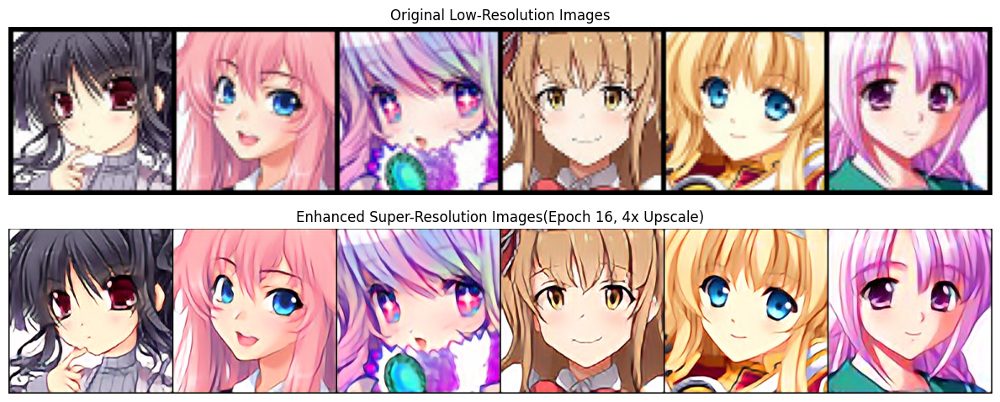

Epoch [17/25], Batch [0/313] => Discriminator Loss: 0.0639, Generator Loss: 0.0064, Batch Time: 6.0273
Epoch [17/25], Batch [10/313] => Discriminator Loss: 0.0478, Generator Loss: 0.0066, Batch Time: 4.5912
Epoch [17/25], Batch [20/313] => Discriminator Loss: 0.0293, Generator Loss: 0.0075, Batch Time: 4.2780
Epoch [17/25], Batch [30/313] => Discriminator Loss: 0.0462, Generator Loss: 0.0069, Batch Time: 4.4067
Epoch [17/25], Batch [40/313] => Discriminator Loss: 0.0202, Generator Loss: 0.0073, Batch Time: 5.1605
Epoch [17/25], Batch [50/313] => Discriminator Loss: 0.0259, Generator Loss: 0.0069, Batch Time: 4.6900
Epoch [17/25], Batch [60/313] => Discriminator Loss: 0.0224, Generator Loss: 0.0069, Batch Time: 9.6226
Epoch [17/25], Batch [70/313] => Discriminator Loss: 0.0174, Generator Loss: 0.0072, Batch Time: 5.0462
Epoch [17/25], Batch [80/313] => Discriminator Loss: 0.0452, Generator Loss: 0.0069, Batch Time: 6.2995
Epoch [17/25], Batch [90/313] => Discriminator Loss: 0.0232, Gene

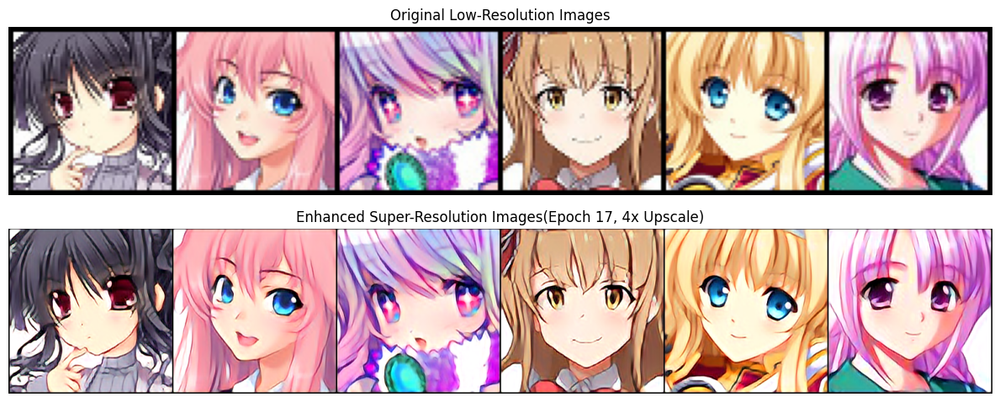

Epoch [18/25], Batch [0/313] => Discriminator Loss: 0.0379, Generator Loss: 0.0071, Batch Time: 12.8845
Epoch [18/25], Batch [10/313] => Discriminator Loss: 0.0389, Generator Loss: 0.0073, Batch Time: 5.2383
Epoch [18/25], Batch [20/313] => Discriminator Loss: 0.0441, Generator Loss: 0.0075, Batch Time: 7.3264
Epoch [18/25], Batch [30/313] => Discriminator Loss: 0.0907, Generator Loss: 0.0073, Batch Time: 4.3549
Epoch [18/25], Batch [40/313] => Discriminator Loss: 0.0696, Generator Loss: 0.0069, Batch Time: 4.0762
Epoch [18/25], Batch [50/313] => Discriminator Loss: 0.1463, Generator Loss: 0.0066, Batch Time: 7.0972
Epoch [18/25], Batch [60/313] => Discriminator Loss: 0.0517, Generator Loss: 0.0077, Batch Time: 4.9557
Epoch [18/25], Batch [70/313] => Discriminator Loss: 0.1389, Generator Loss: 0.0070, Batch Time: 4.2463
Epoch [18/25], Batch [80/313] => Discriminator Loss: 0.0625, Generator Loss: 0.0068, Batch Time: 5.0481
Epoch [18/25], Batch [90/313] => Discriminator Loss: 0.0626, Gen

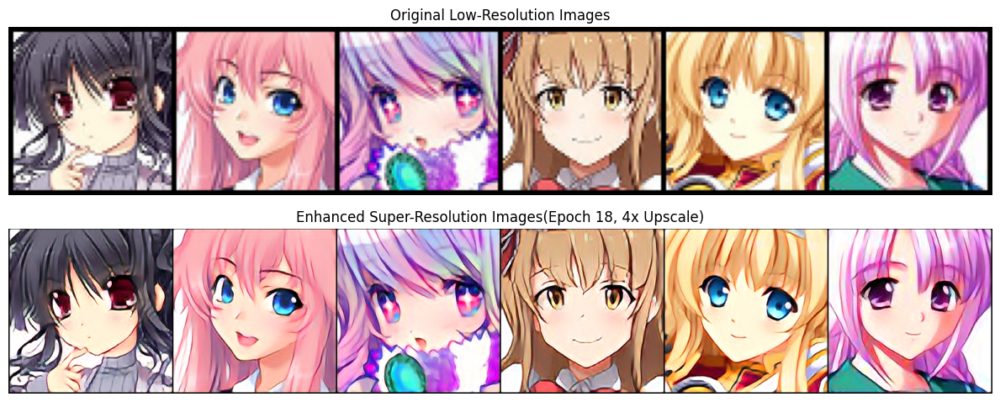

Epoch [19/25], Batch [0/313] => Discriminator Loss: 0.2642, Generator Loss: 0.0086, Batch Time: 8.0014
Epoch [19/25], Batch [10/313] => Discriminator Loss: 0.2849, Generator Loss: 0.0095, Batch Time: 5.1339
Epoch [19/25], Batch [20/313] => Discriminator Loss: 0.4861, Generator Loss: 0.0099, Batch Time: 4.0972
Epoch [19/25], Batch [30/313] => Discriminator Loss: 0.3243, Generator Loss: 0.0091, Batch Time: 4.2100
Epoch [19/25], Batch [40/313] => Discriminator Loss: 0.1001, Generator Loss: 0.0069, Batch Time: 4.3669
Epoch [19/25], Batch [50/313] => Discriminator Loss: 0.2799, Generator Loss: 0.0074, Batch Time: 5.5649
Epoch [19/25], Batch [60/313] => Discriminator Loss: 0.4288, Generator Loss: 0.0094, Batch Time: 4.7075
Epoch [19/25], Batch [70/313] => Discriminator Loss: 0.2389, Generator Loss: 0.0080, Batch Time: 3.9606
Epoch [19/25], Batch [80/313] => Discriminator Loss: 0.0760, Generator Loss: 0.0079, Batch Time: 4.0177
Epoch [19/25], Batch [90/313] => Discriminator Loss: 0.0493, Gene

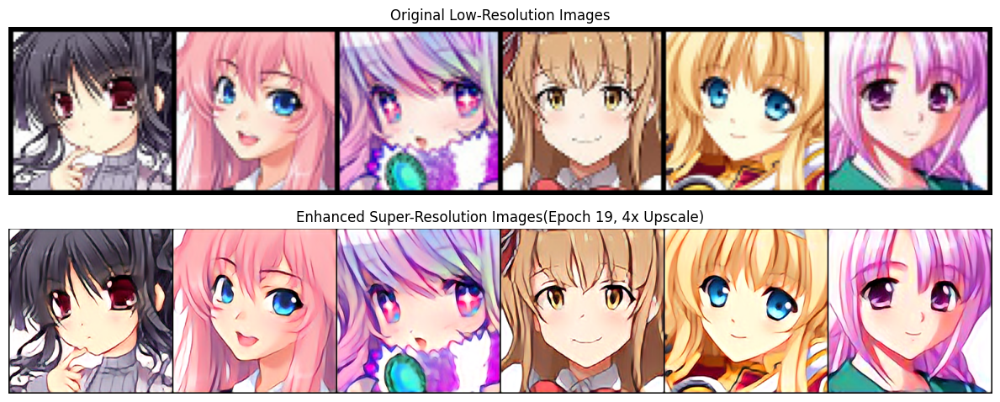

Epoch [20/25], Batch [0/313] => Discriminator Loss: 0.0480, Generator Loss: 0.0061, Batch Time: 5.8088
Epoch [20/25], Batch [10/313] => Discriminator Loss: 0.0302, Generator Loss: 0.0068, Batch Time: 4.5703
Epoch [20/25], Batch [20/313] => Discriminator Loss: 0.0329, Generator Loss: 0.0071, Batch Time: 4.0485
Epoch [20/25], Batch [30/313] => Discriminator Loss: 0.0416, Generator Loss: 0.0068, Batch Time: 3.9835
Epoch [20/25], Batch [40/313] => Discriminator Loss: 0.0566, Generator Loss: 0.0072, Batch Time: 4.1359
Epoch [20/25], Batch [50/313] => Discriminator Loss: 0.0598, Generator Loss: 0.0074, Batch Time: 5.0064
Epoch [20/25], Batch [60/313] => Discriminator Loss: 0.0573, Generator Loss: 0.0064, Batch Time: 4.5875
Epoch [20/25], Batch [70/313] => Discriminator Loss: 0.0584, Generator Loss: 0.0068, Batch Time: 4.4422
Epoch [20/25], Batch [80/313] => Discriminator Loss: 0.0491, Generator Loss: 0.0064, Batch Time: 4.4377
Epoch [20/25], Batch [90/313] => Discriminator Loss: 0.0488, Gene

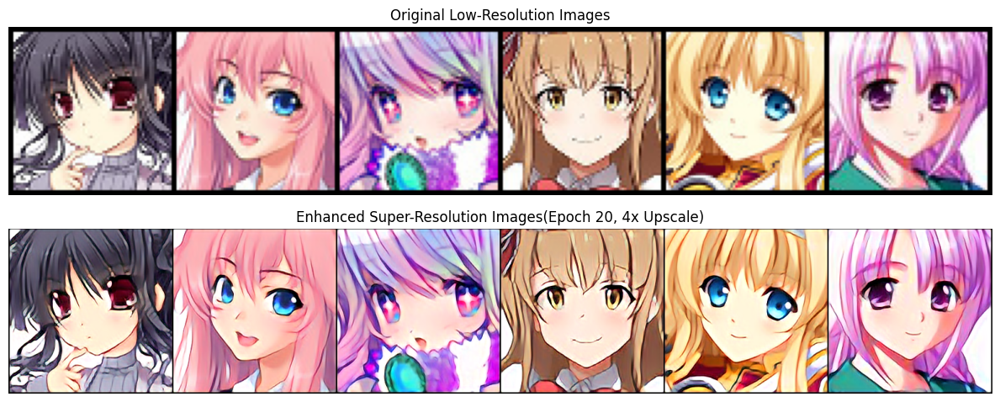

Epoch [21/25], Batch [0/313] => Discriminator Loss: 0.0612, Generator Loss: 0.0076, Batch Time: 9.3801
Epoch [21/25], Batch [10/313] => Discriminator Loss: 0.1092, Generator Loss: 0.0067, Batch Time: 12.7842
Epoch [21/25], Batch [20/313] => Discriminator Loss: 0.1224, Generator Loss: 0.0069, Batch Time: 5.1286
Epoch [21/25], Batch [30/313] => Discriminator Loss: 0.0831, Generator Loss: 0.0064, Batch Time: 4.4054
Epoch [21/25], Batch [40/313] => Discriminator Loss: 0.0335, Generator Loss: 0.0073, Batch Time: 4.6763
Epoch [21/25], Batch [50/313] => Discriminator Loss: 0.0490, Generator Loss: 0.0066, Batch Time: 4.3731
Epoch [21/25], Batch [60/313] => Discriminator Loss: 0.1080, Generator Loss: 0.0063, Batch Time: 4.0784
Epoch [21/25], Batch [70/313] => Discriminator Loss: 0.1420, Generator Loss: 0.0058, Batch Time: 18.7874
Epoch [21/25], Batch [80/313] => Discriminator Loss: 0.0584, Generator Loss: 0.0078, Batch Time: 14.7194
Epoch [21/25], Batch [90/313] => Discriminator Loss: 0.0747, G

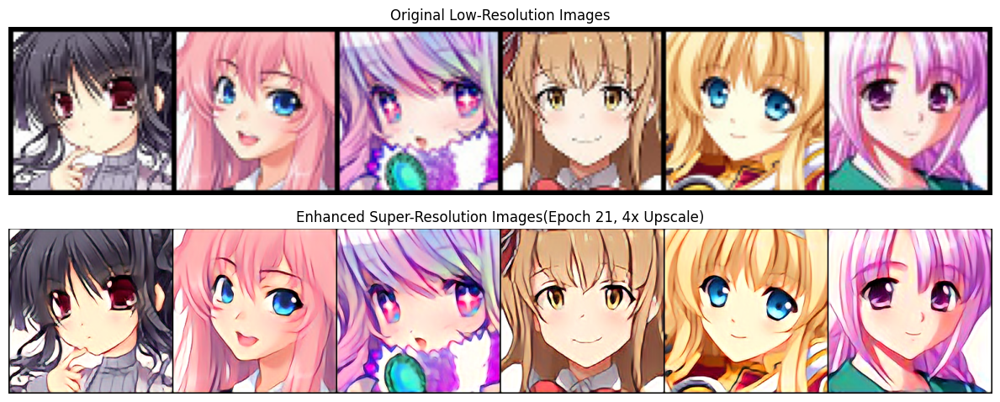

Epoch [22/25], Batch [0/313] => Discriminator Loss: 0.0961, Generator Loss: 0.0076, Batch Time: 4.8525
Epoch [22/25], Batch [10/313] => Discriminator Loss: 0.0605, Generator Loss: 0.0072, Batch Time: 4.3634
Epoch [22/25], Batch [20/313] => Discriminator Loss: 0.0980, Generator Loss: 0.0071, Batch Time: 7.5499
Epoch [22/25], Batch [30/313] => Discriminator Loss: 0.0523, Generator Loss: 0.0074, Batch Time: 4.5582
Epoch [22/25], Batch [40/313] => Discriminator Loss: 0.0793, Generator Loss: 0.0057, Batch Time: 5.3317
Epoch [22/25], Batch [50/313] => Discriminator Loss: 0.0691, Generator Loss: 0.0068, Batch Time: 4.9454
Epoch [22/25], Batch [60/313] => Discriminator Loss: 0.0744, Generator Loss: 0.0072, Batch Time: 4.0387
Epoch [22/25], Batch [70/313] => Discriminator Loss: 0.1486, Generator Loss: 0.0066, Batch Time: 5.6189
Epoch [22/25], Batch [80/313] => Discriminator Loss: 0.0657, Generator Loss: 0.0067, Batch Time: 4.4468
Epoch [22/25], Batch [90/313] => Discriminator Loss: 0.1147, Gene

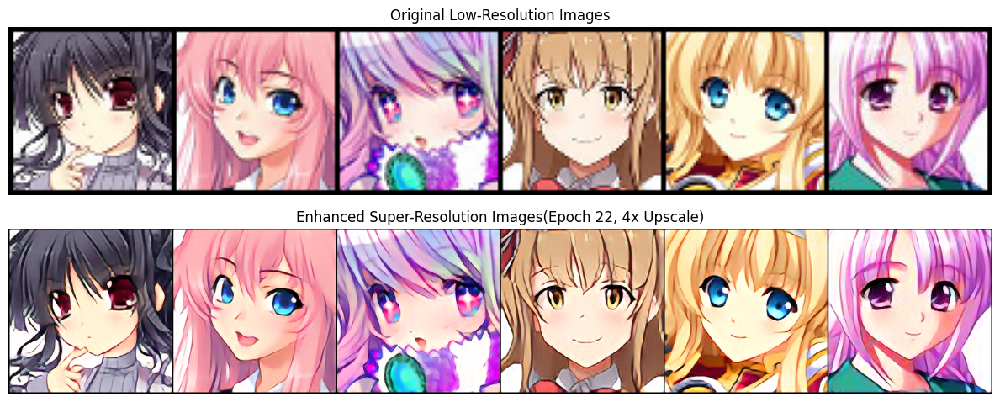

Epoch [23/25], Batch [0/313] => Discriminator Loss: 0.1069, Generator Loss: 0.0065, Batch Time: 6.0493
Epoch [23/25], Batch [10/313] => Discriminator Loss: 0.0525, Generator Loss: 0.0068, Batch Time: 4.3847
Epoch [23/25], Batch [20/313] => Discriminator Loss: 0.0446, Generator Loss: 0.0066, Batch Time: 4.5503
Epoch [23/25], Batch [30/313] => Discriminator Loss: 0.0567, Generator Loss: 0.0060, Batch Time: 4.0179
Epoch [23/25], Batch [40/313] => Discriminator Loss: 0.0337, Generator Loss: 0.0067, Batch Time: 3.9787
Epoch [23/25], Batch [50/313] => Discriminator Loss: 0.0444, Generator Loss: 0.0069, Batch Time: 4.0072
Epoch [23/25], Batch [60/313] => Discriminator Loss: 0.0340, Generator Loss: 0.0067, Batch Time: 4.0215
Epoch [23/25], Batch [70/313] => Discriminator Loss: 0.0380, Generator Loss: 0.0067, Batch Time: 4.0575
Epoch [23/25], Batch [80/313] => Discriminator Loss: 0.0516, Generator Loss: 0.0060, Batch Time: 4.7578
Epoch [23/25], Batch [90/313] => Discriminator Loss: 0.0191, Gene

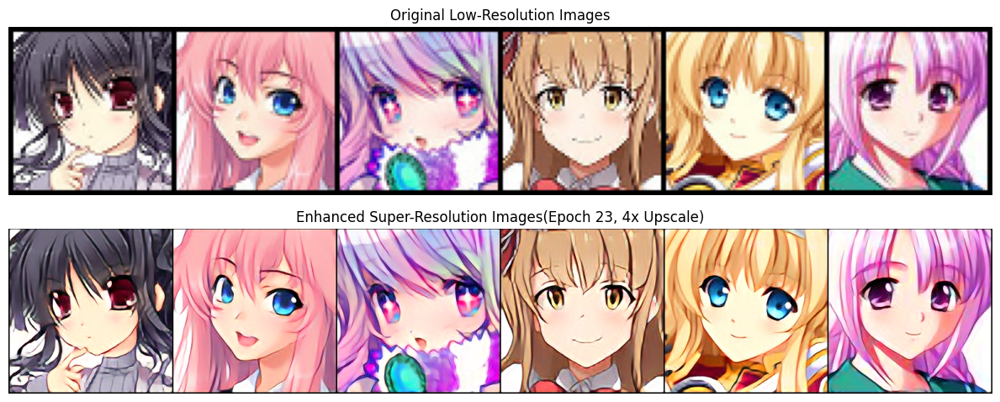

Epoch [24/25], Batch [0/313] => Discriminator Loss: 0.0528, Generator Loss: 0.0072, Batch Time: 5.4073
Epoch [24/25], Batch [10/313] => Discriminator Loss: 0.0390, Generator Loss: 0.0066, Batch Time: 4.0098
Epoch [24/25], Batch [20/313] => Discriminator Loss: 0.0333, Generator Loss: 0.0070, Batch Time: 4.3112
Epoch [24/25], Batch [30/313] => Discriminator Loss: 0.0376, Generator Loss: 0.0064, Batch Time: 4.7661
Epoch [24/25], Batch [40/313] => Discriminator Loss: 0.0387, Generator Loss: 0.0064, Batch Time: 4.0497
Epoch [24/25], Batch [50/313] => Discriminator Loss: 0.0664, Generator Loss: 0.0059, Batch Time: 4.0066
Epoch [24/25], Batch [60/313] => Discriminator Loss: 0.0351, Generator Loss: 0.0068, Batch Time: 4.9844
Epoch [24/25], Batch [70/313] => Discriminator Loss: 0.0288, Generator Loss: 0.0062, Batch Time: 4.0650
Epoch [24/25], Batch [80/313] => Discriminator Loss: 0.0254, Generator Loss: 0.0067, Batch Time: 4.8540
Epoch [24/25], Batch [90/313] => Discriminator Loss: 0.0441, Gene

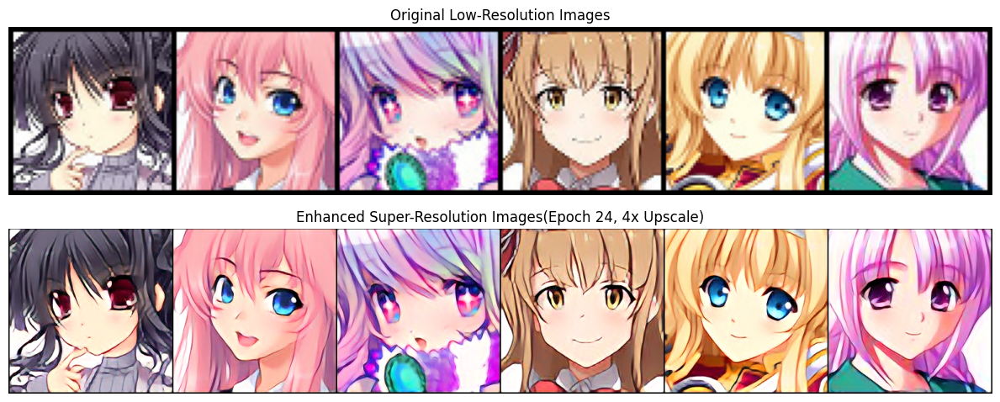

Epoch [25/25], Batch [0/313] => Discriminator Loss: 0.0367, Generator Loss: 0.0064, Batch Time: 4.9610
Epoch [25/25], Batch [10/313] => Discriminator Loss: 0.0351, Generator Loss: 0.0076, Batch Time: 3.9960
Epoch [25/25], Batch [20/313] => Discriminator Loss: 0.0664, Generator Loss: 0.0069, Batch Time: 4.0521
Epoch [25/25], Batch [30/313] => Discriminator Loss: 0.0600, Generator Loss: 0.0068, Batch Time: 4.0088
Epoch [25/25], Batch [40/313] => Discriminator Loss: 0.0730, Generator Loss: 0.0067, Batch Time: 4.0047
Epoch [25/25], Batch [50/313] => Discriminator Loss: 0.0293, Generator Loss: 0.0062, Batch Time: 4.7192
Epoch [25/25], Batch [60/313] => Discriminator Loss: 0.0622, Generator Loss: 0.0069, Batch Time: 4.1824
Epoch [25/25], Batch [70/313] => Discriminator Loss: 0.0617, Generator Loss: 0.0060, Batch Time: 4.2757
Epoch [25/25], Batch [80/313] => Discriminator Loss: 0.0632, Generator Loss: 0.0062, Batch Time: 4.0079
Epoch [25/25], Batch [90/313] => Discriminator Loss: 0.0502, Gene

In [22]:
lr_images_sample, hr_images_sample = next(iter(dataloader))
lr_images_sample = lr_images_sample.to(device)

for epoch in range(num_epochs):
    epoch_start_time = time.time()
    generator.train()
    discriminator.train()

    # Plot images only once before each epoch
    with torch.no_grad():
        sr_images_sample = torch.clamp(generator(lr_images_sample), 0, 1)
    plot_and_save_images(lr_images_sample, sr_images_sample, epoch)

    
    for batch_idx, (lr_images, hr_images) in enumerate(dataloader):
        batch_start_time = time.time()
        # Move images to device
        lr_images = lr_images.to(device)
        hr_images = hr_images.to(device)

        # Create target labels for discriminator training
        valid_labels = torch.ones((lr_images.size(0), 1, hr_images.size(2), hr_images.size(3)),
                                    requires_grad=False).to(device)
        fake_labels = torch.zeros((lr_images.size(0), 1, hr_images.size(2), hr_images.size(3)),
                                   requires_grad=False).to(device)

        # Generate super-resolved images from low-resolution images
        sr_images = generator(lr_images)  # e.g. 64x64 --> 128x128 or 64x64 --> 256x256

        # Clamp images to valid range [0, 1]
        sr_images = torch.clamp(sr_images, 0, 1)
        lr_images = torch.clamp(lr_images, 0, 1)

        # ---------------------
        # Train Discriminator
        # ---------------------
        optimizer_d.zero_grad()  # Reset gradients for discriminator
        real_preds = discriminator(hr_images)
        fake_preds = discriminator(sr_images.detach())
        d_loss = relativistic_loss(real_preds, fake_preds)
        d_loss.backward()
        optimizer_d.step()

        # ---------------------
        # Train Generator
        # ---------------------
        optimizer_g.zero_grad()  # Reset gradients for generator
        fake_preds = discriminator(sr_images)
        fake_preds = fake_preds.view_as(valid_labels)
        g_adv_loss = adversarial_loss(fake_preds, valid_labels)
        g_content_loss = content_loss(sr_images, hr_images)
        g_perceptual_loss = feature_extractor(sr_images, hr_images)
        g_loss = g_content_loss + g_adv_loss * 1e-3 + g_perceptual_loss * 1e-2
        g_loss.backward()
        optimizer_g.step()

        # Save losses
        generator_losses.append(g_loss.item())
        discriminator_losses.append(d_loss.item())

        batch_end_time = time.time()

        if batch_idx % 10 == 0:
            print(f'Epoch [{epoch + 1}/{num_epochs}], Batch [{batch_idx}/{len(dataloader)}] ', end="=> ")
            print(f'Discriminator Loss: {d_loss.item():.4f}, Generator Loss: {g_loss.item():.4f}', end=", ")
            print(f"Batch Time: {(batch_end_time - batch_start_time):.4f}")

        # Cleanup to free memory
        del fake_preds, g_adv_loss, g_content_loss, g_perceptual_loss, g_loss, sr_images, lr_images, hr_images
        if device == torch.device("cuda"):
            torch.cuda.empty_cache()
        elif device == torch.device("mps"):
            torch.mps.empty_cache()

    # Update learning rate schedulers
    scheduler_g.step()
    scheduler_d.step()
    epoch_end_time = time.time()
    print("Epoch Time:", epoch_end_time - epoch_start_time)

    # Save model checkpoint
    torch.save({
        'generator_state_dict': generator.state_dict(),
        'epoch': epoch,
    }, f'models/generator_{upscale_factor}x_epoch_{epoch + 1}.pth')


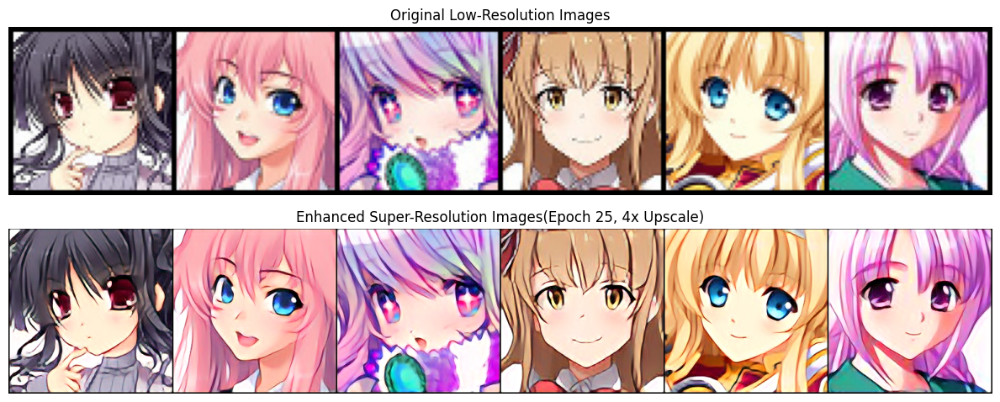

In [23]:
with torch.no_grad():
    sr_images_sample = torch.clamp(generator(lr_images_sample), 0, 1)
plot_and_save_images(lr_images_sample, sr_images_sample, num_epochs)

In [24]:
torch.save({
'generator_state_dict': generator.state_dict(),
'epoch': num_epochs,
}, f'models/final_generator_{upscale_factor}x.pth')
print(f'Latest model checkpoint saved')

# Save final loss data
loss_data = {
    "generator_losses": generator_losses,
    "discriminator_losses": discriminator_losses
}

with open(f"models/losses_final_{upscale_factor}x.json", "w") as f:
    json.dump(loss_data, f)

print(f"Final loss data saved in models/losses_final_{upscale_factor}x.json")

Latest model checkpoint saved
Final loss data saved in models/losses_final_4x.json


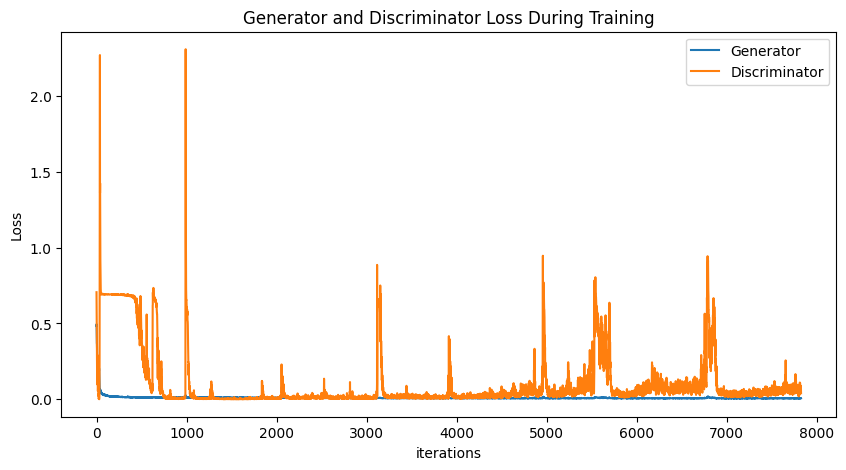

In [25]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generator_losses,label="Generator")
plt.plot(discriminator_losses,label="Discriminator")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()